Github: https://github.com/caumente/time-series-analysis

# Import libraries and dataset

Import all the necessary libraries to perform the the time series analysis

In [2]:
import pandas as pd
import statistics
import matplotlib.pyplot as plt

%matplotlib inline

import seaborn as sns
from plotly import graph_objects as go
import statsmodels.api as sm
from statsmodels.tsa.seasonal import seasonal_decompose

We will import the data provided to us. In this case, we can verify that the values are separated by tabs and without a header. In addition, we are going to name the three columns as 'date', 'time' and 'value', imposing that the columns 'date' and 'time' have date and time format, so that we will combine them to form a single one.

In [3]:
df = pd.read_csv("Demanda_2015.txt", 
                 sep="\t", 
                 header=None, 
                 names=["date", "time", "value"], 
                 parse_dates=[['date', 'time']]
                )

First of all, let's see a sample of the dataset sorted by date.

In [4]:
df.reset_index(drop=True, inplace=True)
df.sort_values("date_time", inplace=True)

print("Size of dataset: {}".format(len(df)))
print("First date: {} ".format(min(df.date_time)))
print("Last date: {} ".format(max(df.date_time)))
print("There are {} duplicate date".format(len(df)- len(df.drop_duplicates())))
df.head(10)

Size of dataset: 52560
First date: 2015-01-01 00:00:00 
Last date: 2015-12-31 23:50:00 
There are 0 duplicate date


,date_time,value
0,2015-01-01 00:00:00,25459
1,2015-01-01 00:10:00,25591
2,2015-01-01 00:20:00,25531
3,2015-01-01 00:30:00,25453
4,2015-01-01 00:40:00,25329
5,2015-01-01 00:50:00,25247
6,2015-01-01 01:00:00,25093
7,2015-01-01 01:10:00,24853
8,2015-01-01 01:20:00,24678
9,2015-01-01 01:30:00,24391


The range in which measurements have been made goes from January 1 to December 31, 2015, in time intervals of 10 minutes. We have checked that there were no duplicate dates, and for even more security it has been verified that the length of the dataset is 52560 = 356 days x 24 hours / day x 6 values / hours.

# Exploratory data analysis

To visualize the data, as there is a huge amount of them, we will use an interactive library that allows us to zoom in, see the value of the series at each point or make selections of areas, among other things. This will help us to see more in detail the naturalness of the series.

In [5]:
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=df.date_time, 
    y=df.value, 
    line_color='deepskyblue'))

fig.update_layout(
    template = "plotly_white",
    title_text="Time Serie for Electrical Consumtion",
    xaxis_rangeslider_visible=True)

fig.show()

In order to continue understanding how the series behaves, we will reel it out for months and paint it. We are going to do this.

In [6]:
df['month'] = df.date_time.dt.month

months = list(set(df.month))

for month in months:
    _df = df[df.month == month]
    fig = go.Figure()

    fig.add_trace(go.Scatter(
        x=_df.date_time, 
        y=_df.value, 
        line_color='deepskyblue')
        )

    fig.update_layout(
        template = "plotly_white",
        title_text="Time Serie for month " + str(month)
        )

    fig.show()

df.drop(columns=["month"], inplace=True)

After these 12 graphs, it can be seen that in most months the last three weeks are quite well defined, there is a clear trend in which from Monday to Friday consumption increases and decreases during the day and night respectively, and at come the weekend this consumption declines.

Despite this, by having a temporal granularity every 10 minutes, it is difficult to appreciate the behavior of the series. In order to understand it better, we are going to make several graphs at different levels of aggregation.

In [7]:
#Split by month
df_monthly = df.set_index('date_time').resample('M').sum().reset_index(drop=True)
print("Size of dataframe grouped by month: {}".format(len(df_monthly)))

#Split by week
df_weekly = df.set_index('date_time').resample('W').sum().reset_index(drop=True)
print("Size of dataframe grouped by week: {}".format(len(df_weekly)))

#Split by day
df_daily = df.set_index('date_time').resample('d').sum().reset_index(drop=True)
print("Size of dataframe grouped by day: {}".format(len(df_daily)))

#Split by session daily
df_sess_d = df.assign(session = pd.cut(df.date_time.dt.hour,[0,6,12,18,23], 
                                     labels=['Night','Morning','Afternoon','Evening'],
                                     include_lowest=True))
df_sess_d["day"] = df.date_time.dt.day
df_sess_d = df_sess_d.groupby(["session","day"]).sum().reset_index()
print("Size of dataframe grouped by session daily: {}".format(len(df_sess_d)))

#Split by session monthly
df_sess_m = df.assign(session = pd.cut(df.date_time.dt.hour,[0,6,12,18,23], 
                                     labels=['Night','Morning','Afternoon','Evening'],
                                     include_lowest=True))
df_sess_m["month"] = df.date_time.dt.month
df_sess_m = df_sess_m.groupby(["session","month"]).sum().reset_index()
print("Size of dataframe grouped by session monthly: {}".format(len(df_sess_m)))


Size of dataframe grouped by month: 12
Size of dataframe grouped by week: 53
Size of dataframe grouped by day: 365
Size of dataframe grouped by session daily: 124
Size of dataframe grouped by session monthly: 48


Once we have created different levels of aggregation, let's see their behavior.

## Monthly

We will start by visualizing the behavior of electricity demand on a monthly basis.

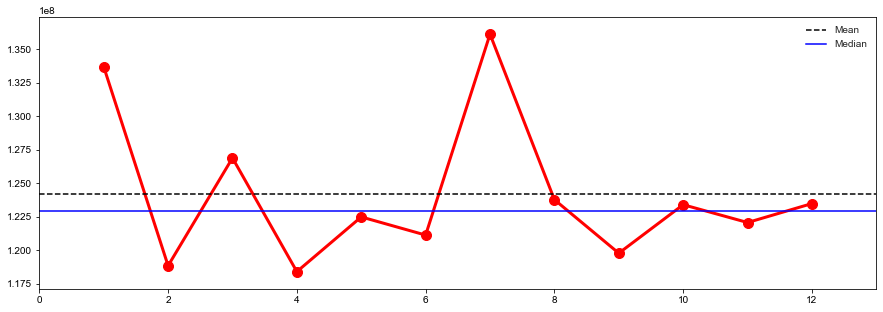

In [8]:
fig= plt.figure(figsize=(15, 5))
mean = df_monthly.values.mean(axis=0)
median = statistics.median(df_monthly.values)
plt.plot(df_monthly.index+1, df_monthly.values, c='r', linewidth=3)
plt.scatter(df_monthly.index+1, df_monthly.values, c='red', s=100)
plt.axhline(y=mean, label='Mean', linestyle='--', color='black')
plt.axhline(y=median, label='Median', linestyle='-', color='b')
plt.style.use('seaborn-whitegrid')
plt.xlim([0,13])
plt.legend()
plt.show()

As we can see, we do not find a clear trend in electricity demand as the months advance. What we can see is that most of the months are close to the mean, and even closer to the median (a more robust magnitude in the face of the outlier disturbance. There are only two that disturb the data, January and August.

## Weekly

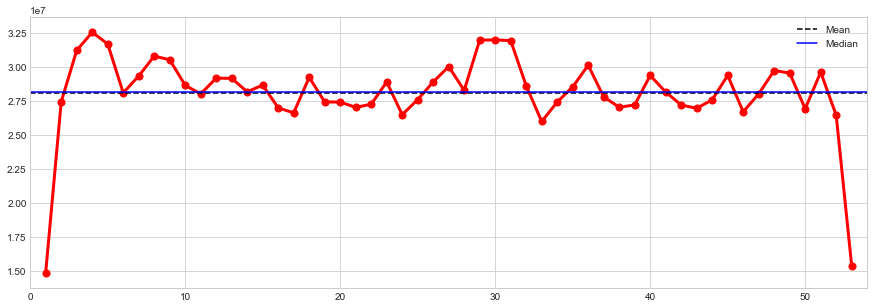

In [9]:
fig= plt.figure(figsize=(15, 5))
mean = df_weekly.values.mean(axis=0)
median = statistics.median(df_weekly.values)
plt.plot(df_weekly.index+1, df_weekly.values, c='r', linewidth=3)
plt.scatter(df_weekly.index+1, df_weekly.values, c='red', s=50)
plt.axhline(y=mean, label='Mean', linestyle='--', color='black')
plt.axhline(y=median, label='Median', linestyle='-', color='b')
plt.style.use('seaborn-whitegrid')
plt.xlim([0,54])
plt.legend()
plt.show()

As can be seen, the electrical consumption values are very close to both the mean and the median (whose values practically coincide). It should be noted how the first week and the last one differ a lot from the rest because they are not completely complete. January 1, 2015 started on Thursday, so that week has 3 days left. In the same way, the last week of the year was from a Monday to a Thursday, which is actually missing the values for 2016 that we do not have. We can see it clearly with the following line:

In [10]:
print("\nFirst week \n {}\n".format(df_weekly.head(1)))
print("\nLast week \n {}\n".format(df_weekly.tail(1)))


First week 
       value
0  14883861


Last week 
        value
52  15360114



## Daily

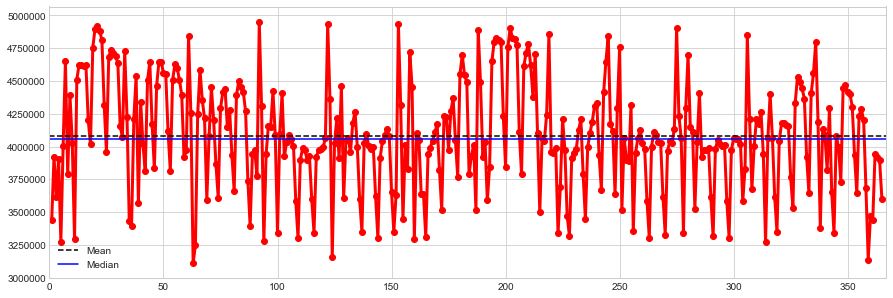

In [11]:
fig= plt.figure(figsize=(15, 5))
mean = df_daily.values.mean(axis=0)
median = statistics.median(df_daily.values)
plt.plot(df_daily.index+1, df_daily.values, c='r', linewidth=3)
plt.scatter(df_daily.index+1, df_daily.values, c='red')
plt.axhline(y=mean, label='Mean', linestyle='--', color='black')
plt.axhline(y=median, label='Median', linestyle='-', color='b')
plt.style.use('seaborn-whitegrid')
plt.legend()
plt.xlim([0,367])
plt.show()

## By session monthly

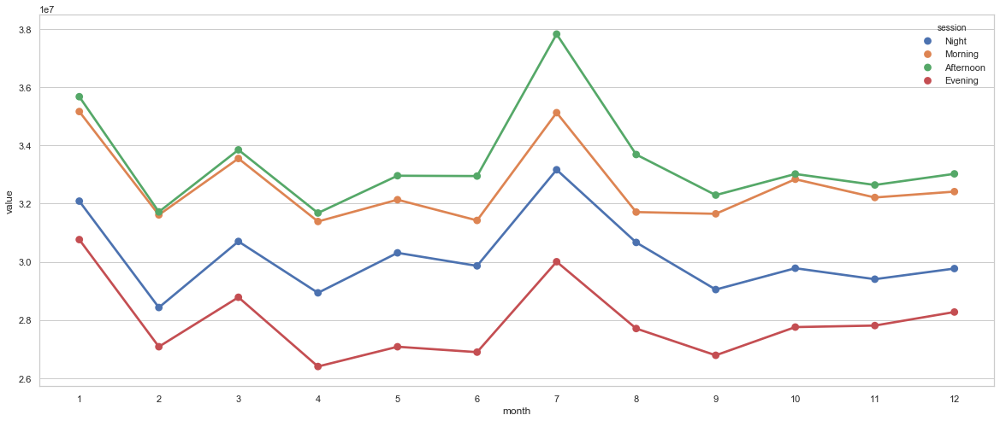

In [12]:
sns.set(rc={'figure.figsize':(20,8)})
sns.set_style("whitegrid")
sns.pointplot(x="month", y="value", data=df_sess_m, hue='session')
#sns.lmplot(x="day", y="value", data=df_sess, hue='session')
plt.show()

### By session daily

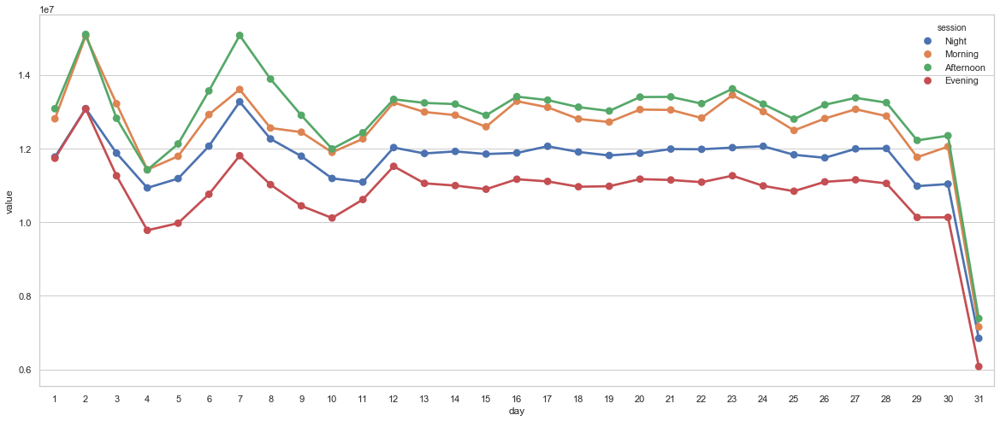

In [13]:
# Use the 'hue' argument to provide a factor variable
sns.set(rc={'figure.figsize':(20,8)})
sns.set_style("whitegrid")
sns.pointplot(x="day", y="value", data=df_sess_d, hue='session')
#sns.lmplot(x="day", y="value", hue="session", data=df_sess_d)
plt.show()

The intervals that have been chosen to denote the labels 'Nigh', 'Morning', 'Afternoon' and 'Evening' have been [0,6], [6,12], [12,18] and [18,24] respectively. We can see how the curves in the different time bands do not intersect at any time, that is, in an aggregate way, in the morning and in the afternoon there is always more electricity demand than at night and at dawn.

It can be ruled out that on the 31st the fall in demand is quite large. This makes a lot of sense, since not all months have 31 days and therefore, the contribution to the aggregate of that day will generally be less. In the same way, having a frequency of 2015 28 days, days 29 and 30 are somewhat below normal.

In order to give more explanations to phenomena such as that more energy is consumed on days 7, perhaps we should have more information such as where the data are measured, what events occurred, weather, etc.

# Analysis of trend,  seasonality and residual

Finally we are going to study the trend, seasonality and residuals of the series. As we have such a large amount of data, what we will do is take a sample from one of the months, for example April.

In [14]:
df_april = df[df.date_time.dt.month == 4][["date_time", "value"]]
df_april.reset_index(inplace=True, drop=True)
df_april.head(10)

,date_time,value
0,2015-04-01 00:00:00,28150
1,2015-04-01 00:10:00,27617
2,2015-04-01 00:20:00,27163
3,2015-04-01 00:30:00,26834
4,2015-04-01 00:40:00,26526
5,2015-04-01 00:50:00,25926
6,2015-04-01 01:00:00,25672
7,2015-04-01 01:10:00,24897
8,2015-04-01 01:20:00,24636
9,2015-04-01 01:30:00,24313


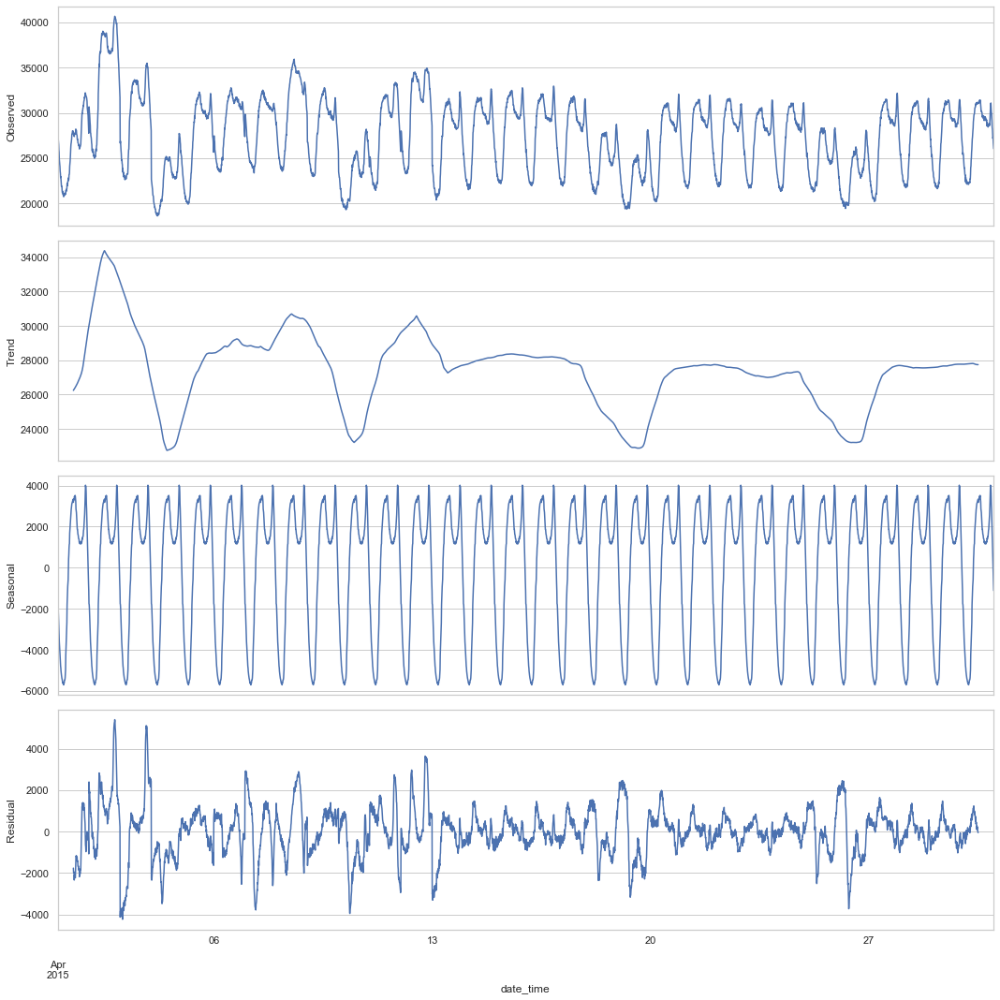

In [15]:
plt.rcParams['figure.figsize'] = [15, 15]
df_april.index = df_april.date_time
df_april.sort_index(inplace=True)
serie = df_april.value
result = seasonal_decompose(serie, model='additive', freq=144)
result.plot()
plt.show()

As we can see, the series can be perfectly decomposed into its three components, observing a very clear periodicity when we eliminate the trend and the residuals to the series. This periodicity perfectly reflects day and night, increasing and decreasing electrical consumption respectively.

On the other hand, the trend shows us the weekly behavior that we already knew existed. There are clearly four points where the curve becomes concave, coinciding with the weekends of April 2015.

Waste, for its part, provides us with clear information that there is a more dispersed consumption, especially the first days of the month, as well as on weekends.

## Autocorrelation

Autocorrelation plots are often used for checking randomness in time series. This is done by computing autocorrelations for data values at varying time lags. If time series is random, such autocorrelations should be near zero for any and all time-lag separations. If time series is non-random then one or more of the autocorrelations will be significantly non-zero. The horizontal lines displayed in the plot correspond to 95% and 99% confidence bands. The dashed line is 99% confidence band. See the Wikipedia entry for more about autocorrelation plots.

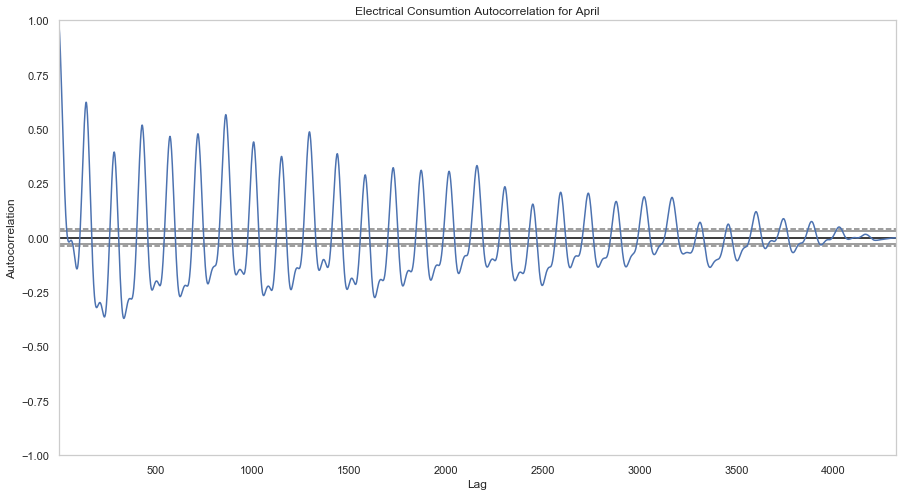

In [16]:
plt.rcParams['figure.figsize'] = [15, 8]
pd.plotting.autocorrelation_plot(serie)
plt.title("Electrical Consumtion Autocorrelation for April")
plt.show()

## Partial Autocorrelation

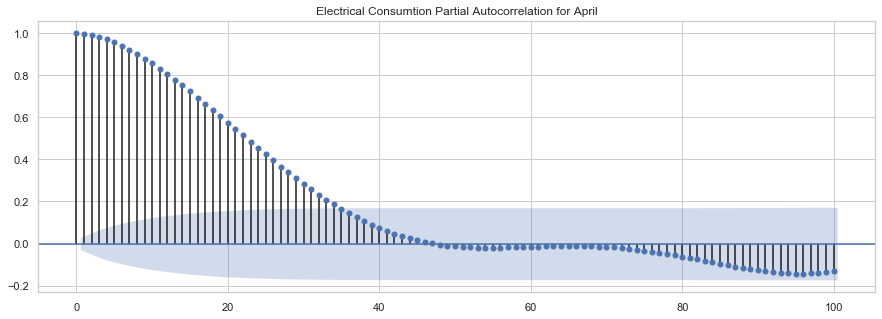

In [17]:
plt.rcParams['figure.figsize'] = [15, 5]
sm.graphics.tsa.plot_acf(serie.squeeze(), lags=100, title='Electrical Consumtion Partial Autocorrelation for April')
plt.show()

# Outliers detection

We know that an outlier is an observation that is numerically distant or atypical with respect to the rest of the data. These outliers are sometimes a subjective matter, and there are numerous methods to classify them. One of the most used methods is known as the Tukey test, which takes as a reference the difference between the first quartile $ Q_1 $ and the third quartile $ Q_3 $, or interquartile range. In a box plot, an outlier is considered to be one that is 1.5 times that distance from one of these quartiles (mild outlier) or 3 times that distance (extreme outlier).
Like the previous section, let's look at these outliers at different levels of aggregation.

## Monthly

In [18]:
fig = go.Figure()

df['month'] = df.date_time.dt.month
fig.add_trace(go.Box(
    y=df.value,
    x=df.month,
    marker_color = 'coral',
    name="Suspected Outliers",
    boxpoints='suspectedoutliers' # only suspected outliers
))

fig.update_layout(template = "plotly_white", title_text="Box Plot per month")
fig.show()

df.drop(columns=["month"], inplace=True)

## Daily

In [19]:
fig = go.Figure()

df['day'] = df.date_time.dt.day
fig.add_trace(go.Box(
    y=df.value,
    x=df.day,
    marker_color = 'coral',
    name="Suspected Outliers",
    boxpoints='suspectedoutliers' # only suspected outliers
))

fig.update_layout(template = "plotly_white", title_text="Box Plot per day")
fig.show()

df.drop(columns=["day"], inplace=True)

Adding the data monthly and daily, we did not find any outlier that separates more than 1.5 times the interquartile range on $ Q_1 $ or $ Q_3 $.

## Weekly

In [20]:
fig = go.Figure()

df['week'] = df.date_time.dt.week

fig.add_trace(go.Box(
    y=df.value,
    x=df.week,
    marker_color = 'coral',
    name="Suspected Outliers",
    boxpoints='suspectedoutliers' # only suspected outliers
))

fig.update_layout(template = "plotly_white", title_text="Box Plot per week")
fig.show()


This is where we start to find the records that could be candidates for outliers. We see how in week 18 there are points that exceed the limits of the box plot. Find us in detail:

In [21]:
#Interquartilic range
Q1 = df[df.week == 18]["value"].quantile(0.25)
Q3 = df[df.week == 18]["value"].quantile(0.75)
IQR = Q3 - Q1
print("IQR for week 18: {}".format(Q1 - 1.5 * IQR))

df[(df.week == 18) & (df.value > Q3 + 1.5*IQR)]

IQR for week 18: 17434.875


,date_time,value,week
5155,2015-05-02 19:10:00,39646,18
5156,2015-05-02 19:20:00,39756,18
5157,2015-05-02 19:30:00,40160,18
5158,2015-05-02 19:40:00,40310,18
5159,2015-05-02 19:50:00,40491,18
5160,2015-05-02 20:00:00,40293,18
5161,2015-05-02 20:10:00,40349,18
5162,2015-05-02 20:20:00,40087,18
5163,2015-05-02 20:30:00,40161,18
5164,2015-05-02 20:40:00,40069,18


In [22]:
print("Hay {} outliers en la semana 18.".format(len(df[(df.week == 18) & (df.value > Q3 + 1.5*IQR)])))


Hay 14 outliers en la semana 18.


There we have it, there are 14 records that could be considered outliers according to the criteria that we have discussed previously.

In [23]:
outliers = df[(df.week == 18) & (df.value > Q3 + 1.5*IQR)].index.values.tolist()
df.drop(columns=["week"], inplace=True)

## Hourly

Let's do the same search with intervals grouped by hours.

In [24]:
fig = go.Figure()

df['hour'] = df.date_time.dt.hour

fig.add_trace(go.Box(
    y=df.value,
    x=df.hour,
    marker_color = 'coral',
    name="Suspected Outliers",
    boxpoints='suspectedoutliers' # only suspected outliers
))

fig.update_layout(template = "plotly_white", title_text="Box Plot for every hour")
fig.show()

In [25]:
horas = list(set(df.hour.values.tolist()))
horas

for h in horas:
    df_ = df[df.hour == h]
    Q1 = df_.value.quantile(0.25)
    Q3 = df_.value.quantile(0.75)
    IQR = Q3 - Q1
    df_ = df_[df_.value > (Q3 + 1.5*IQR)]
    
    print("\nEl número de outliers para la hora {} es: {}".format(h, len(df_)))
    outliers.extend(df_.index.values.tolist())

df.drop(columns=["hour"], inplace=True)


El número de outliers para la hora 0 es: 2

El número de outliers para la hora 1 es: 23

El número de outliers para la hora 2 es: 33

El número de outliers para la hora 3 es: 23

El número de outliers para la hora 4 es: 2

El número de outliers para la hora 5 es: 0

El número de outliers para la hora 6 es: 0

El número de outliers para la hora 7 es: 0

El número de outliers para la hora 8 es: 0

El número de outliers para la hora 9 es: 0

El número de outliers para la hora 10 es: 0

El número de outliers para la hora 11 es: 0

El número de outliers para la hora 12 es: 0

El número de outliers para la hora 13 es: 0

El número de outliers para la hora 14 es: 6

El número de outliers para la hora 15 es: 1

El número de outliers para la hora 16 es: 0

El número de outliers para la hora 17 es: 0

El número de outliers para la hora 18 es: 0

El número de outliers para la hora 19 es: 0

El número de outliers para la hora 20 es: 0

El número de outliers para la hora 21 es: 13

El número de ou

# Studying of a forecasting algorithm

Paper: Forecasting at Scale. Sean J. Taylor and Benjamin Letham. (https://peerj.com/preprints/3190.pdf)

##### 1. Introducción y motivación

The authors begin by talking about how the task of forcasting (or forecasting) in one of the main activities in the field of data science within organizations, regardless of the sector to which they are dedicated. Despite this, performing this task with high quality is not easy because fully automatic forcasting techniques can be difficult to 'tune' or are often inflexible when incorporating assumptions or heuristics, or because the specialists of the Organizations have deep knowledge about the business and its products and services, but are not as familiar with the use of time series. This leads to the fact that the demand for quality forcasts often exceeds with growth the rate at which it can be produced, and it is what motivated them to carry out this paper, to try to provide a useful guide to produce forecasts at different scales.

They then comment that it is true that there is a wide diversity of business forecasting problems, however, there are some characteristics common to many of them. Relying on a time series with 4-year data, they commented on how there were seasonal effects (weekly and annual cycles), a pronounced decline around Christmas and New Years, changes in the trend in recent months, and even outliers, thus showing the difficulties to produce reasonable forecasts with fully automated methods. Using R as software, they tried to make predictions using the functions: auto.arima, ets, snaive, and tbats. They found problems with all of them, but the most difficult thing is that to be able to adjust the models well, it is necessary to know in depth how each one of them works and what parameters we must adjust, that is what is really difficult to scale.

At this moment and as a consequence of the previous paragraph, it is where the model you will use comes into the picture, which is designed to have intuitive parameters that can be adjusted without knowing the details of the underlying model.

##### 2. The forecasting model

The time series model can be decomposed into (additive model):

\begin{equation}
y (t) = g (t) + s (t) + h (t) + \epsilon_t
\end{equation}

where g (t) is the trend function that models non-periodic changes, s (t) represents periodic changes in seasonality, h (t) represents the effects of vacations that occur at potentially irregular hours for one or more days, and $ \ epsilon_t $ represents the error that the model is unable to accommodate.

In effect, they frame the forecasting problem as a curve-fitting exercise, forgoing some important advantages that an ARIMA would provide. This formulation offers a number of practical advantages:

   - Flexibility: We can easily adapt seasonality with multiple periods and let the analyst make different assumptions about trends.

   - Unlike ARIMA models, measurements do not need to be regularly spaced, and we do not need to interpolate missing values, for example by removing outliers.

   - Tuning is very fast, allowing the analyst to interactively explore many model specifications.

   - The forecasting model has easily interpretable parameters that the analyst can change to impose assumptions on the forecast. Additionally, analysts are often experienced with regression and can easily expand the model to include new components.

<b>2.1 The trend of the model</b>

The authors have implemented two trend models: a saturated growth model and a piecewise linear model.

    a) Nonlinear saturating growth
    
Often times the growth of the series can be non-linear and saturate. This type of growth is generally modeled using the logistic growth model:

\begin{equation}
    g(t) = \frac{C}{1 + exp(-k(t - m))}
\end{equation}
   
with C the carrying capacity, k the growth rate, and m a displacement parameter. Considering that this capacity does not really have to be constant and neither does the growth rate, so the article actually proposes to use a function to model the trend of the form:

\begin{equation}
       g(t) = \frac{C(t)}{1 + exp(-(k + a(t)^T\delta)(t - (m + a(t)^T)))}
\end{equation}

    b) Linear trend with change points

To forecast problems that do not exhibit saturated growth, it is often helpful to use a constant growth rate in parts of the form:

\begin{equation}
       g(t) = (k + a(t)^T \delta)t + (m + a(t)^T\gamma)
\end{equation}


where as before k is the growth rate, δ has the rate adjustments, m is the displacement parameter and γj is set to −sjδj so that the function is continuous.

With this we see that the analyst can specify the turning points using known dates that alter growth, or can be selected automatically based on a set of candidates. Automatic selection can be done quite naturally by making use of the $\delta$ parameter seen above, which directly controls the flexibility of the model by altering its speed.
   
When the model is extrapolated beyond history to make a forecast, the trend will have a constant rate. In addition, the certainty in the forecast trend is measured assuming that the future will see the same average frequency and magnitude of the rate changes that were observed in the historical data. This assumption is quite strong, so the confidence intervals of this model are not expected to have exact coverage.

<b>2.2 Seasonality</b>

Time series often have multi-period seasonality as a result of the human behaviors they represent. To fit and forecast these effects, we must specify seasonality models with periodic functions of t. We can approximate smooth and arbitrary seasonal effects with a Fourier series, but after treating it, we arrive at that seasonality will be described by the equation:

\begin{equation}
        s (t) = X (t)?
\end{equation}

where $\beta$ is described by a normal distribution with parameters N (0, $\sigma^2 $).

<b>2.3 Holidays and events</b>

Holidays and events provide large and somewhat predictable shocks for many time series and often do not follow a periodic pattern, so their effects are not well modeled by a uniform cycle. Incorporating this list of vacations into the model is simplified by assuming that the effects of vacations are independent. This model adds an indicator function that represents whether the instant $t$ corresponds to the holiday $i$, assigning to each holiday a parameter $\kappa_i$, corresponding to the change in the forecast. Analogously to how it has been done for seasonality, we obtain that:


\begin{equation}
        h (t) = Z (t) \ kappa
\end{equation}

Again with $\kappa$ following a normal distribution N (0, $\nu^2$), and where $ Z (t) $ is a dependent function of $D_i$, which is nothing more than the set of past dates and future around every holiday $i$.

<b>2.4 Model fit</b>

To fit the model, they used Stan's L-BFGSS (Basically it is a way to find a local minimum of the values of an objective function and its gradient) to find a maximum posterior estimate. With this, they showed the forecast of the model for the time series with which they were working, obtaining that they were able to predict the weekly and annual seasonality without overreacting to the fall in vacations in the first year.

<b>2.5 Loop analyst modeling</b>

Forecasting analysts often have extensive domain knowledge over the quantity they forecast, but limited statistical knowledge. That is why in this model, there are several points where analysts can tune the model to apply their external knowledge and experience without requiring any understanding of the underlying statistics. Some examples that we have already discussed are the known dates of the switching points, holidays and seasonality, smoothing parameters, capabilities, etc. Adding this to some good visualization tools, we can easily improve the fit of the model. 

##### 3. Automated forecast evaluation

Finally, they end up describing a procedure to automate the assessment of forecast performance, comparing various methods and identifying forecasts in which manual intervention is justified. When there are too many forecasts for analysts to manually check each of them, it is important to be able to automatically identify the forecasts that may be problematic. Automatic identification of bad forecasts allows analysts to use their time in the most effective way, and to use their experience to correct any problems. We understand that problems will be occurring:


- When the forecast has large errors in relation to the baselines, the model may be poorly specified, so we will have to adjust the model for trend or seasonality, as necessary.
- Large errors for all methods on a particular date suggest outliers. Analysts can identify outliers and eliminate them.
- When the SHF error for a method increases sharply from one cut-off point to the next, it could indicate that the data generation process has changed. Adding change points or modeling different phases separately can address the problem

There are pathologies that cannot be easily corrected, but most of the problems they encountered can be corrected by specifying switch points and removing outliers. These issues are easily identified and corrected once the forecast has been marked for review and display.

# Forecasting

Using the model explained above, we will try to predict the values of the electricity demand between Monday, June 8 and Sunday, June 14. To do this, we import the necessary libraries first.

In [26]:
from fbprophet import Prophet
from sklearn.metrics import mean_absolute_error, mean_squared_error
from math import sqrt
import numpy as np

def mean_absolute_percentage_error(y_true, y_pred): 

    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [27]:
# Filtramos las fechas que nos interesan
data = df[df.date_time < '2015-06-08 00:00:00']
data.columns = ["ds", "y"]
data

,ds,y
0,2015-01-01 00:00:00,25459
1,2015-01-01 00:10:00,25591
2,2015-01-01 00:20:00,25531
3,2015-01-01 00:30:00,25453
4,2015-01-01 00:40:00,25329
...,...,...
26923,2015-06-07 23:10:00,34030
26924,2015-06-07 23:20:00,33410
26925,2015-06-07 23:30:00,32899
26926,2015-06-07 23:40:00,32516


In [28]:
# Entrenamos nuestro modelo
model = Prophet(interval_width=0.95, daily_seasonality=True, weekly_seasonality=True
               ).add_country_holidays(country_name='ES')
model.fit(data)

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


In [29]:
# Seleccionamos el intervalo de tiempos que queremos predecir
#future_dates = model.make_future_dataframe(periods=6*4, freq='10min')
future_dates = model.make_future_dataframe(periods=6*4*6*7, freq='10min')
future_dates.tail()

,ds
23755,2015-06-14 23:10:00
23756,2015-06-14 23:20:00
23757,2015-06-14 23:30:00
23758,2015-06-14 23:40:00
23759,2015-06-14 23:50:00


In [30]:
# Aplicamos el modelo entrenado sobre nuestro conjunto de datos.
forecast = model.predict(future_dates)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
23755,2015-06-14 23:10:00,27399.726885,21595.657372,33227.668096
23756,2015-06-14 23:20:00,27033.430949,20951.982568,33455.243090
23757,2015-06-14 23:30:00,26663.449347,20546.784785,32311.241742
23758,2015-06-14 23:40:00,26293.257768,20965.532216,32108.195490
23759,2015-06-14 23:50:00,25926.114007,19745.085707,32090.371292


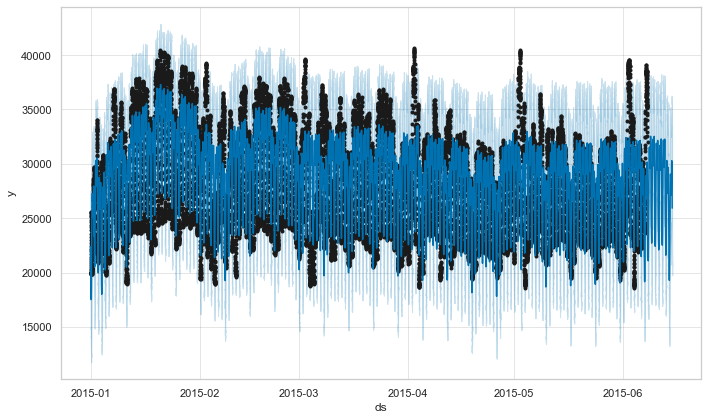

In [31]:
# Plot de los resultados
model.plot(forecast, uncertainty=True);

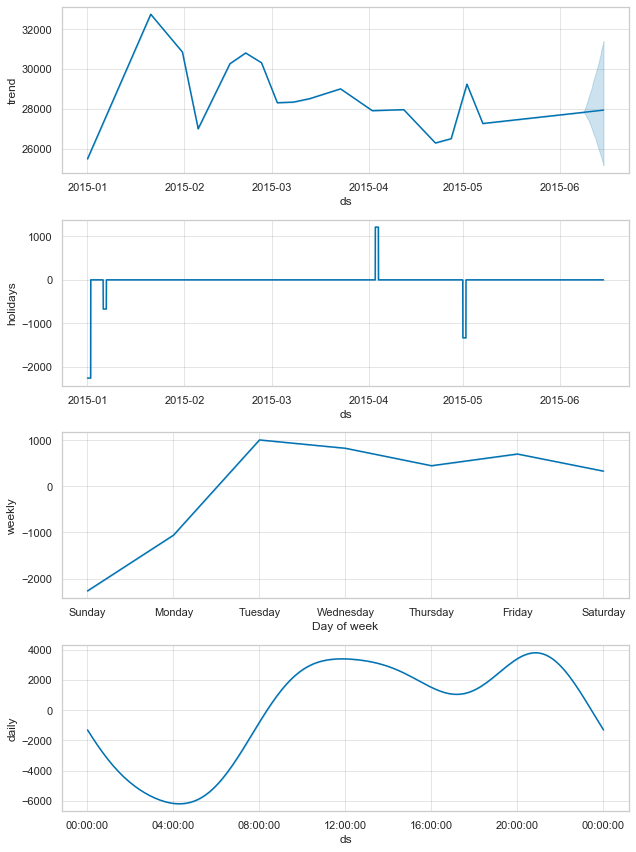

In [32]:
# We show the trend observed by the model
model.plot_components(forecast);

In [33]:
forecast.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,Asunción de la Virgen,Asunción de la Virgen_lower,Asunción de la Virgen_upper,Año nuevo,...,holidays,holidays_lower,holidays_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
23755,2015-06-14 23:10:00,27936.288671,21595.657372,33227.668096,25189.621494,31375.322121,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,-1162.027188,-1162.027188,-1162.027188,0.0,0.0,0.0,27399.726885
23756,2015-06-14 23:20:00,27936.409224,20951.982568,33455.243090,25185.170631,31381.933114,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,-1141.423232,-1141.423232,-1141.423232,0.0,0.0,0.0,27033.430949
23757,2015-06-14 23:30:00,27936.529777,20546.784785,32311.241742,25180.719769,31388.544107,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,-1120.775788,-1120.775788,-1120.775788,0.0,0.0,0.0,26663.449347
23758,2015-06-14 23:40:00,27936.650331,20965.532216,32108.195490,25176.268906,31395.155100,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,-1100.088322,-1100.088322,-1100.088322,0.0,0.0,0.0,26293.257768
23759,2015-06-14 23:50:00,27936.770884,19745.085707,32090.371292,25171.818043,31401.766094,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,-1079.364294,-1079.364294,-1079.364294,0.0,0.0,0.0,25926.114007


In [34]:
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=forecast.ds, 
    y=forecast.yhat, 
    line_color='deepskyblue',
    name='yhat'))

fig.add_trace(go.Scatter(
    x=forecast.ds, 
    y=forecast.yhat_lower, 
    line_color='salmon',
    name='yhat_lower'))

fig.add_trace(go.Scatter(
    x=forecast.ds, 
    y=forecast.yhat_upper, 
    line_color='#3CD05D',
    name='yhat_upper'))


fig.update_layout(
    template = "plotly_white",
    title_text="Time Serie for Electrical Consumtion",
    xaxis_rangeslider_visible=True)

fig.show()

In [35]:
#Seleccionamos los datos predichos por el modelo y los reales
y_pred = forecast["yhat"].loc[forecast.ds >= '2015-06-08 00:00:00']
y_real = df["value"].loc[(df.date_time >= '2015-06-08 00:00:00') & (df.date_time <= '2015-06-14 23:50:00')]

print("Size of forecast: {}".format(len(y_pred)))

Size of forecast: 1008


In [36]:
#Evaluamos nuestro modelo con algunas métricas
print("Mean absolute percentage error (MAPE): {}".format(mean_absolute_percentage_error(y_real, y_pred)))
print("Mean absolute error (MAE): {}".format(mean_absolute_error(y_real, y_pred)))
print("Root mean squared error (RMSE): {}".format(sqrt(mean_squared_error(y_real, y_pred))))

Mean absolute percentage error (MAPE): 10.422284915177402
Mean absolute error (MAE): 2671.5661513857212
Root mean squared error (RMSE): 3504.9647288392594


The errors made in percentage are not bad at all, we can also make some comments about it. Let's look at two graphs that we showed at the beginning of the practice. On the one hand we had the data aggregated per week. If we go to the calendar we can verify that week 24 is the one that corresponds to the days between June 8 and 14. It is true that it is not the week that deviates the most below the average value, but it is one of the ones that deviates the most. On the other hand, we have the data grouped by day in another of the graphs. We can also verify that the days with the greatest variability were the first of the month, and that from the 12th they were much more stable. Combining these two arguments, we can conclude that the week we have tried to predict was not the simplest possible.

To verify this, let's do an experiment. Let's make a prediction of the same time interval using the same model, but this time taking week 25. This week is closer to the mean of the average values, and also includes the days from 15 to 22, much more stable days. We see what happens:

In [37]:
data2 = df[df.date_time < '2015-06-15 00:00:00']
data2.columns = ["ds", "y"]
model2 = Prophet(interval_width=0.95, daily_seasonality=True, weekly_seasonality=True
               ).add_country_holidays(country_name='ES')
model2.fit(data2)
future_dates2 = model2.make_future_dataframe(periods=6*4*6*7, freq='10min')
forecast2 = model2.predict(future_dates2)

y_pred2 = forecast2["yhat"].loc[forecast2.ds >= '2015-06-15 00:00:00']
y_real2 = df["value"].loc[(df.date_time >= '2015-06-15 00:00:00') & (df.date_time <= '2015-06-21 23:50:00')]

print("Size of forecast: {}".format(len(y_pred2)))

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Size of forecast: 1008


In [38]:
#Evaluamos nuestro modelo con algunas métricas
print("Mean absolute percentage error (MAPE): {}".format(mean_absolute_percentage_error(y_real2, y_pred2)))
print("Mean absolute error (MAE): {}".format(mean_absolute_error(y_real2, y_pred2)))
print("Root mean squared error (RMSE): {}".format(sqrt(mean_squared_error(y_real2, y_pred2))))

Mean absolute percentage error (MAPE): 4.3173375622092856
Mean absolute error (MAE): 1148.4864027402605
Root mean squared error (RMSE): 1400.1524372640513


As we guessed, this week you get much smaller errors than the previous one. In fact, we have managed to lower the MAPE by more than 50%.

We can conclude that this model is simple, fits the data quite well, tends to predict trends moderately well, and is highly customizable.

In [39]:
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].to_csv("solution.csv", index=False)